# Step 3 | Image Classification with CNN on 3 classes only

Given the high computational cost in displacing more than 5GB of photos to Google Drive as well as training a Convolutional Neural Network (CNN) on 101000 images, I will build a first image classification prototype on Jupyter Notebook based on three classes only: <mark>**donuts**</mark>, <mark>**hamburger**</mark> and <mark>**pizza**</mark>.<br/> 
Then, I will expand the CNN algorithm to the full dataset by using Google Colab and the relatd GPU.

In [1]:
#######################
# standard code block #
#######################

%pylab inline
%reload_ext autoreload
%autoreload 2
%matplotlib inline

# sets backend to render higher res images
%config InlineBackend.figure_formats = ['retina']

#######################
#       imports       #
#######################

# standard data munging modules
import numpy as np
import pandas as pd
import collections
from collections import defaultdict
import random

# visualization modules
import seaborn as sns
import matplotlib.image as img
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
from sklearn import manifold, datasets
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.metrics import confusion_matrix
from scipy.spatial.distance import squareform
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
from matplotlib.ticker import NullFormatter
import emoji
import PIL


# file and directory operations modules
import os
import simplejson as json
from pathlib import Path
from os import listdir
from os.path import isfile, join
import cv2
from PIL import Image
from shutil import copy
from shutil import copyfile
from shutil import copytree, rmtree

# deep learning modules
import keras
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing import image as keras_image
from keras.preprocessing.image import load_img

# fastai
import fastai.vision as fv
from fastai import *
from fastai.vision import *
from fastai.callbacks import *


sns.set_style("whitegrid")

Populating the interactive namespace from numpy and matplotlib


## Create smaller directories

In this section we will create two new directories, respectively called *train_mini* and *test_mini* containing only the images belonging to the three food classes we selected for this prototype.

In [2]:
# existing paths
path_meta = '/Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/meta/'
path_images = '/Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/'
path_test = '/Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/split/test'
path_train = '/Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/split/train'

# new paths
path_test_mini = path_images+'mini/test_mini'
path_train_mini = path_images+'mini/train_mini'

In [5]:
# make directories
os.makedirs(path_test_mini, exist_ok=True)
os.makedirs(path_train_mini, exist_ok=True)

In [6]:
# create train_mini and test_mini directories
def dataset_mini(food_list, source, destination):
    if os.path.exists(destination):
        rmtree(destination) # remove if already exists
    
    for food_item in food_list :
        print("Copying images into",food_item)
        copytree(os.path.join(source,food_item), os.path.join(destination,food_item))

In [7]:
# pick 3 food items and generate folders in train_mini
dataset_mini(['donuts','hamburger','pizza'], path_train, path_train_mini)

Copying images into donuts
Copying images into hamburger
Copying images into pizza


In [8]:
# pick 3 food items and generate folders in train_mini
dataset_mini(['donuts','hamburger','pizza'], path_test, path_test_mini)

Copying images into donuts
Copying images into hamburger
Copying images into pizza


In [3]:
print(emoji.emojize("Total number of train_mini images :doughnut:"))
!ls -lR /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/train_mini/donuts/*.jpg | wc -l

print(emoji.emojize('Total number of train_mini images :hamburger:'))
!ls -lR /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/train_mini/hamburger/*.jpg | wc -l

print(emoji.emojize("Total number of train_mini images :pizza:"))
!ls -lR /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/train_mini/pizza/*.jpg | wc -l

Total number of train_mini images 🍩
     750
Total number of train_mini images 🍔
     750
Total number of train_mini images 🍕
     750


In [4]:
print(emoji.emojize("Total number of test_mini images :doughnut:"))
!ls -lR /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/test_mini/donuts/*.jpg | wc -l

print(emoji.emojize('Total number of test_mini images :hamburger:'))
!ls -lR /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/test_mini/hamburger/*.jpg | wc -l

print(emoji.emojize("Total number of test_mini images :pizza:"))
!ls -lR /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/test_mini/pizza/*.jpg | wc -l

Total number of test_mini images 🍩
     250
Total number of test_mini images 🍔
     250
Total number of test_mini images 🍕
     250


> Images have been copied correctly to these new folders. Every food class has 750 images as a training sample and 250 images as a test sample.

## Create Dataloader

In this section we will use fast.ai to create the dataloader and we will leverage the fast.ai **image augmentation pipeline**. We will start by defining the parameters for the image augmentation functions.

In [5]:
# batch size
bs = 25

In [6]:
# image augmentation transform functions
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      max_rotate=10.0,
                      max_zoom = 1.1,
                      max_lighting=0.25,
                      max_warp=0.25)

In creating the dataloader, we set up a validation set of 10% of the images belonging to the train set. Also, a random seed is specified to ensure replicatbility. 

In [8]:
# create dataloader
data = (ImageList.from_folder(path_train_mini).split_by_rand_pct(0.1, seed=42) # validation set = 10%
                                       .label_from_folder(classes=None) 
                                       .transform(tfms=tfms, size=256)
                                       .databunch(bs=bs, num_workers=6))

/opt/anaconda3/envs/metis/lib/python3.8/site-packages/fastai/vision/transform.py:247: UserWarning: torch.solve is deprecated in favor of torch.linalg.solveand will be removed in a future PyTorch release.
torch.linalg.solve has its arguments reversed and does not return the LU factorization.
To get the LU factorization see torch.lu, which can be used with torch.lu_solve or torch.lu_unpack.
X = torch.solve(B, A).solution
should be replaced with
X = torch.linalg.solve(A, B) (Triggered internally at  ../aten/src/ATen/native/BatchLinearAlgebra.cpp:760.)
  return _solve_func(B,A)[0][:,0]


In [9]:
data

ImageDataBunch;

Train: LabelList (2025 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
donuts,donuts,donuts,donuts,donuts
Path: /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/train_mini;

Valid: LabelList (225 items)
x: ImageList
Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256),Image (3, 256, 256)
y: CategoryList
hamburger,donuts,donuts,donuts,pizza
Path: /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/train_mini;

Test: None

> As we notice here, we end up with 2025 images in the training set and 225 images in the validation set, across 3 food classes.

## Image Augmentation

Image augmentation is a common technique in deep learning to artificially increase the number of training samples. This way, the model is forced to <mark>**learn more robust/generalizable object patterns**</mark> that are relatively independent of position and hyper-specific quality/coloring. <br/>
We will first consider the effect of a composite image augmentation strategy, and then look at every image augmentation technique individually.

### 1. Composite Image Augmentation

In [29]:
# composite image augmentation applying the transformations defined above
def get_im():
    return open_image(path_train_mini+'/pizza/121834.jpg')

def plots_im(rows, cols, width, height, **kwargs):
    # apply tfms function multiple times
    [get_im().apply_tfms(data.train_ds.tfms, **kwargs).show(ax=ax) for i, ax in enumerate(plt.subplots(
                                                                        rows, cols, figsize=(width, height))[1].flatten())]

Composite Image Augmentation for 🍕 



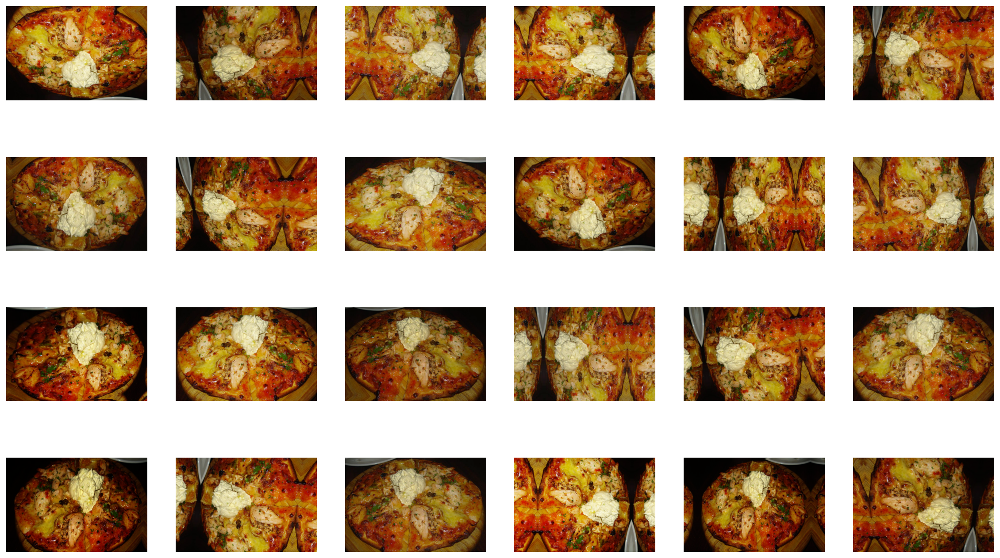

In [32]:
print(emoji.emojize("Composite Image Augmentation for :pizza: \n"))
plots_im(4, 6, 20, 12)

> In the plot above, we see the output of combining merging zooms, rotations, flips, perspective warping and lighting changes.

### 2. Individual Image Augmentations

In [34]:
# define function to plot individual augmentations
def plots_im_indiv(idx, rows, cols, width, height, **kwargs):
    # apply tfms function multiple times
    [get_im().apply_tfms(data.train_ds.tfms[idx], **kwargs).show(ax=ax) for i, ax in enumerate(plt.subplots(
                                                                        rows, cols, figsize=(width, height))[1].flatten())]

### Dihedral Affine Transformation

This technique randomly rotates and flips the image by 90 degrees. This transformation originates from the parameters *do_flip* and *flip_vert* that we specified in the transform function tfms.

Dihedral Affine Transformation for 🍕 



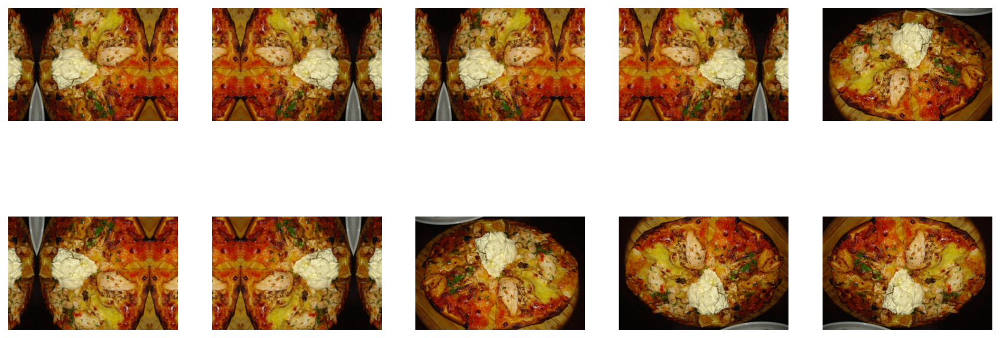

In [40]:
print(emoji.emojize("Dihedral Affine Transformation for :pizza: \n"))
plots_im_indiv(1, 2, 5, 15, 6)

> Clearly some images, especially if not of round shape, will not be really intelligible with vertical flipping. However, for now we will keep this option activated in the transformation function.

### Symmetric Warp

This image augmentation technique changes the angle at which an image is viewed, by applying perspective warping with a certain magnitude.

Symmetric Warp for 🍕 



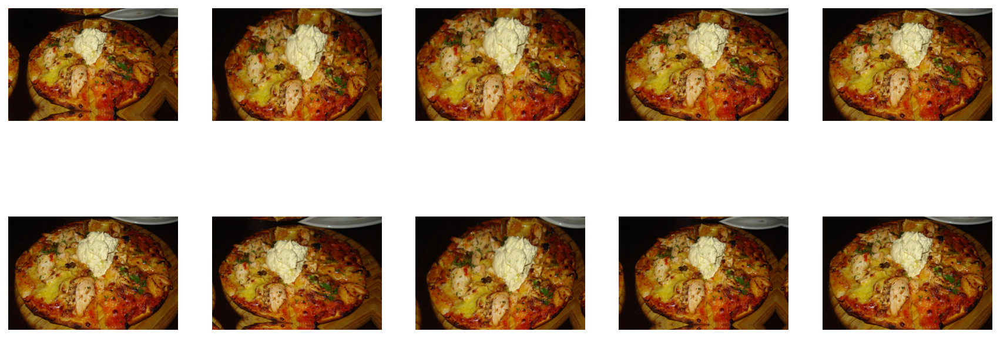

In [41]:
print(emoji.emojize("Symmetric Warp for :pizza: \n"))
plots_im_indiv(2, 2, 5, 15, 6)

### Rotation

This transformation applies a 10 degree clockwise or counterclockwise rotation to the original image.

Rotation for 🍕 



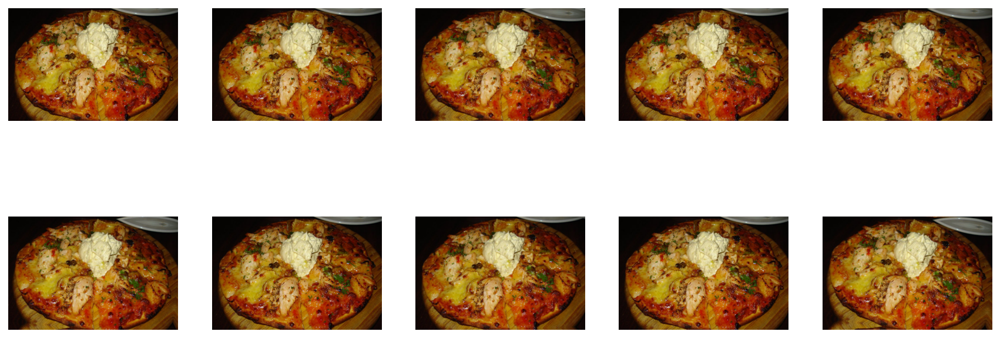

In [42]:
print(emoji.emojize("Rotation for :pizza: \n"))
plots_im_indiv(3, 2, 5, 15, 6)

### Zoom

As defined, this transformation function randomly zooms up to 1.1x the original image. Since many of the photos in the training set are not well-centered, an excessive zoom could crop out important components of the image itself.

Zoom for 🍕 



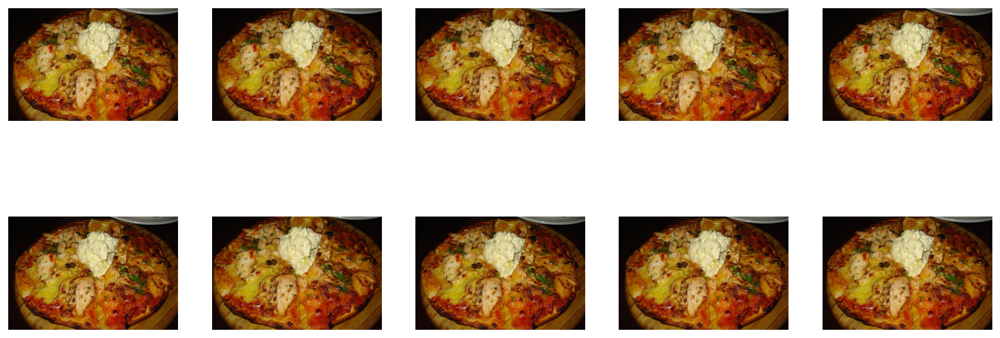

In [44]:
print(emoji.emojize("Zoom for :pizza: \n"))
plots_im_indiv(4, 2, 5, 15, 6)

### Brightness

Brightness, defined by the *max_lighting* parameter in the transformation function is defined as a float between 0 (image transformed to completely black) and 1 (image transformed to completely white). Because many of the photos are relatively poorly taken, applying brightness image augmentation can help in grasping the image content more accurately.

Brightness for 🍕 



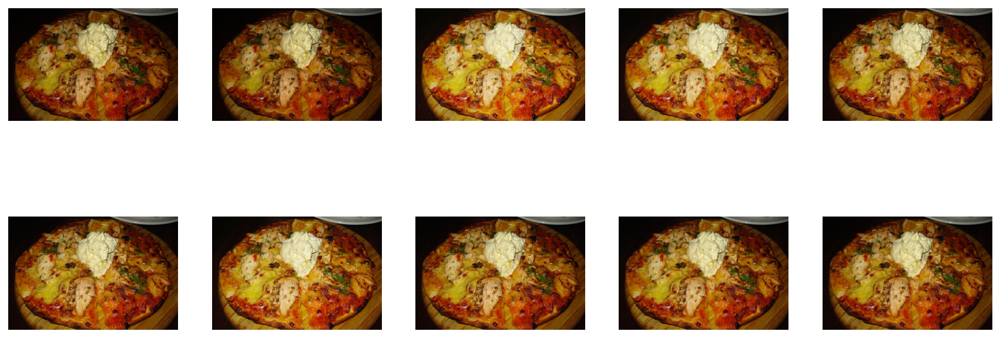

In [46]:
print(emoji.emojize("Brightness for :pizza: \n"))
plots_im_indiv(5, 2, 5, 15, 6)

### Contrast

A value of 0 for contrast transforms the image to grayscale, while a value of 1 does not change the image. Any value above 1 will create an excessive contrast.

Contrast for 🍕 



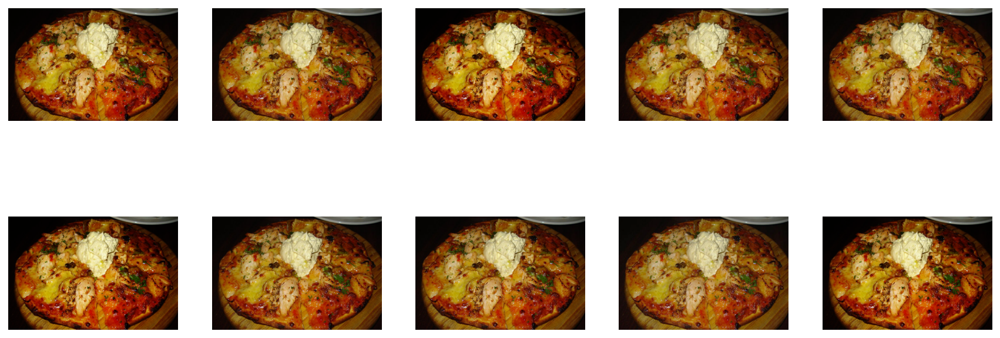

In [48]:
print(emoji.emojize("Contrast for :pizza: \n"))
plots_im_indiv(6, 2, 5, 15, 6)

### 3. Mixup Augmentation

Mixup augmentation, as presented in [this paper](https://arxiv.org/pdf/1710.09412.pdf), is a powerful and effective augmenation technique. At the core, it linearly interpolates between two images to create a new *augmented* image. Then, it computes the new target accordingly. See the representative formulas below. <br/>

$\ image_n = t * image_1 + (1-t) * image_2 $<br/>
$\ target_n = t * target_1 + (1-t) * target_2 $

where $\ image_n $ and $\ target_n $ are respectively the new image and the new target, and $\ t$ is a value between 0 and 1.<br/>

We can then see how mixup augmentation is a strong technique in ensuring that the image classification output is generalizable. It provides strong regularization and is relatively fast to compute on GPU.

Let's now have a look at how different values of $\ t$ transform the image.

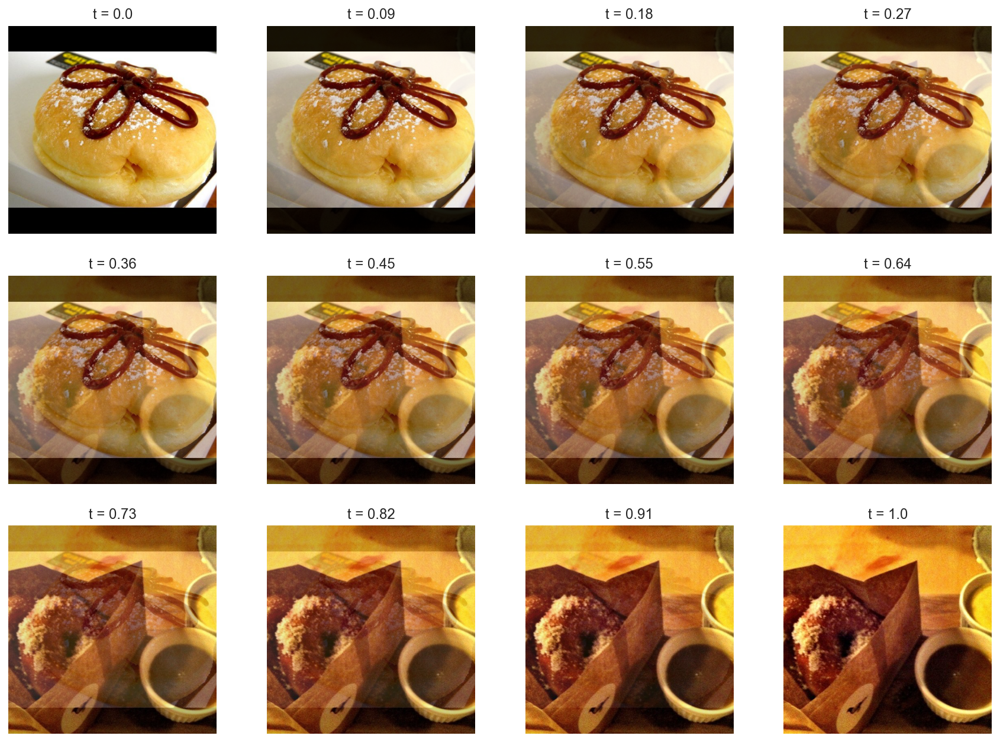

In [64]:
# see how images are augmented depending on t
t_list = list(np.linspace(0,1,12)) # range of t values

fig, axes = plt.subplots(3,4, figsize=(15,11))

for i, ax in enumerate(axes.flat):
    t = t_list[i] # get t value
    mix = t*data.train_ds.x[2].data + (1-t)*data.train_ds.x[100].data # interpolate images
    show_image(mix, ax=ax) # plot interpolation
    ax.set_title('t = ' + str(round(t,2)))

> As we can see from the plot above, when $\ t$ is close to 0 the image is very close to $\ image_2$. Differently, when $\ t$ is close to 1 the image is very close to $\ image_1$.

### Select t 

The value of $\ t$ is drawn from a *beta* distribution with $\alpha$ between 0 and 0.4 to ensure that $\ t$ will be close to either 0 or 1 (i.e. moderate mixup). If $\alpha$ is above 0.4, the probability of $\ t$ being closer to 0.5 will be higher. <br/>

Let's now plot the distribution of $\ t$ for different $\alpha$ values.

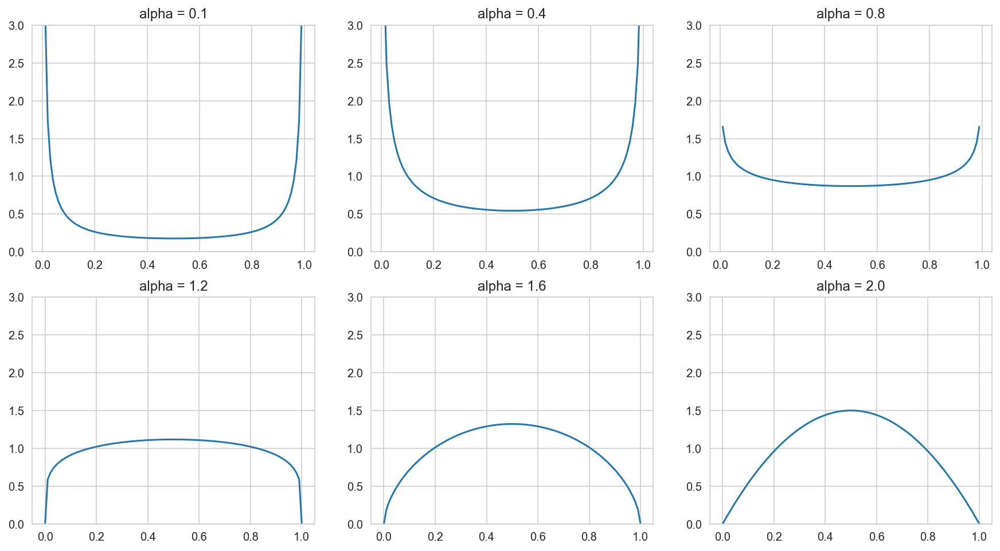

In [73]:
alpha_list = [0.1, 0.4, 0.8, 1.2, 1.6, 2.0] # alpha values
x = torch.linspace(0,1,100) # x axis values

fig, axes = plt.subplots(2,3, figsize=(15,8))

for i, ax in enumerate(axes.flat):
    # code to calculate beta distribution over x values
    alpha = tensor(alpha_list[i])
    B = alpha.lgamma().exp() * alpha.lgamma().exp() / (2*alpha).lgamma().exp()
    y = x**(alpha - 1) * (1-x)**(alpha - 1) / B
    ax.plot(x.numpy(), y.numpy())
    ax.set_title("alpha = " + str(alpha_list[i]))
    ax.set_ylim([0,3])

> To train our model, we will use a **$\alpha$ of 0.4**. This means that, for each batch of training data, we will draw a $\ t$ related to each item in the batch according to the *beta* distribution corresponding to an $\alpha$ of 0.4. Different values of $\ t$ will therefore give each item in the batch a different degree of mixup.

> The fast.ai library conducts mixup augmentation on a batch-level. So, mixup augmentation will occur between elements within a batch rather than across the entire dataset.

### Loss function for mixup augmentation

The objective here is to ensure the $\ t$ parameters used to implement mixup augmentation on the imputs are then propagated to a loss function that computes the cross-entropy loss during mixup. For instance, if during mixup augmentation, $\ image_1$ and $\ image_2$ had respectively the ground truth values of [0,1,0,0] and [0,0,0,1] with a value of $\ t = 0.8$, we would want to perform a cross-entropy loss calculation against ground truth values of [0,0.8,0,0.2]. <br/>

Since cross-entropy in Pytorch can only take integer values for the ground truth, we will have to compute the cross entropy loss twice, one time per element in the mixup, and then interpolate the values. Following the above example we would have:

$\ loss = 0.8*ce(prediction,1) + 0.2*ce(prediction,3)$ <br/>

where $\ ce$ is the cross-entropy loss function

## CNN Training

To start training the model, we adopt a transfer learning approach and start with pre-trained **Resnet-50 model**. <br/>
Let's start with the idea of *vanishing gradient problem*; this occurs when the performance of the deep neural net becomes stagnant or starts degrading when more and more layers are added. This is due to the fact that when gradients are backpropagated through the deep neural network and repeatedly multiplied, this makes gradients extremely small, or *vanishing*. ResNet addresses the *vanishing gradient problem* by introducing a so-called *identity shortcut connection* that **<mark>skips one or more layers<mark/>**. 

Resnet-50 presents 48 Convolution layers along with 1 MaxPool and 1 Average Pool layer. To transfer the pre-trained model to the Food-101 dataset we will add a few linear layers at the end of the model. The model will then be trained in two phases:
1. **Training Phase 1**: freeze pre-trained weights of the ResNet50 model and **<mark>only train the few layers we added at the end of the CNN<mark/>**. In fact, since the new layers will be totally untrained and naive, it would not make sense to allow these layers to backpropagate into the well-tuned ResNet50 standard layers. The objective here is to train the last few linear layers that we added to the model in such a way that they perform decently well before we retrain the whole model.
2. **Training Phase 2**: unfreeze the entire model and train with **<mark>discriminative learning rates<mark/>**. We will train the initial layers at the lower learning rate than the last layers. This is due to the fact that initial layers learn relatively simple components of an image (e.g. edge, shapes, curves) while later layers learn finer aspects of an image. The initial layers, being part of the pre-trained ResNet50 model, are already well-tuned and don't need to be aggressively retrained. Differently, the later layers (especially the ones that we added to the model) need a heavier training to learn the subtleties of our Food-101 dataset.

Regarding the alternation of learning rates, we will follow the **One Cycle Learning Rate** approach (introduced by Leslie Smith in [this paper](https://arxiv.org/abs/1803.09820)). The paper's main finding is that following a particular schedule for learning rate and momentum leads to faster convergence and better generalization. The learning rate will start small and then progressively increase up to a peak, when it will start decreasing again. <br/>

While the learning rate is a hyperparameter that controls how much to change the model in response to the estimated error each time the model weights are updated, momentum can smooth the progression of the learning algorithm that, in turn, can accelerate the training process. Hence, momentum simply adds a fraction m of the previous weight update to the current one. In line with the One Cycle Learning Rate technique, momentum has the opposite schedule to learning rate, by starting high, ramping down, then ramping back up. <br/>

In line with Smith's paper, approximations of the Hessian matrix are smaller when this method is used, indicating that the model has found a flatter part of the loss landscape which should generalize better. 

Our CNN model will be trained in line with the One Cycle Learning Rate technique.

### 1. Training Phase 1 | freeze ResNet50 layers and train new layers

In [103]:
# create learner object from fast.ai library
# learner is a container of the data, the model, the optimizer and other parameters for training
learn = cnn_learner(data, 
                    models.resnet50, 
                    metrics=error_rate,
                    ps=0.4, 
                    wd=5e-3)

# implement mixup augmentation
learn = learn.mixup()

> It's useful to note here that weight decay - which penalizes the model for having large weights - and L2 regularization are equivalent methods for basic SGD, but for more complex optimizers, they are very different. In this specific case, instead of using SGD, we will use the Adam optimizer, which accumulates gradients over multiple time steps. With the gradient update format, which is how the fast.ai library implements weight decay, the gradients are not impacted by weight decay. In this version of the model, I will relax the default parameters to a **dropout value of 0.4** and a **weight decay coefficient of 5e-3**.

In [104]:
# check weight decay
learn.wd

0.005

In [105]:
# check linear head
learn.model[1]

Sequential(
  (0): AdaptiveConcatPool2d(
    (ap): AdaptiveAvgPool2d(output_size=1)
    (mp): AdaptiveMaxPool2d(output_size=1)
  )
  (1): Flatten()
  (2): BatchNorm1d(4096, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (3): Dropout(p=0.2, inplace=False)
  (4): Linear(in_features=4096, out_features=512, bias=True)
  (5): ReLU(inplace=True)
  (6): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (7): Dropout(p=0.4, inplace=False)
  (8): Linear(in_features=512, out_features=3, bias=True)
)

> As we can see, we will have dropout values of 0.2 and 0.4.

In [106]:
# visualize model
learn.model

Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
          (0): Conv2d(64, 256

In [107]:
# check loss function
learn.loss_func

FlattenedLoss of CrossEntropyLoss()

> Loss function is cross-entropy loss.

We will select the learning rate by using the learning rate finder utility in the fast.ai library (see the docs [here](https://fastai1.fast.ai/callbacks.lr_finder.html)). This is very useful in that it identifies how the loss evolves as a function of the learning rate for multiple values of the learning rate. 

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.
Min numerical gradient: 1.91E-04
Min loss divided by 10: 3.02E-04


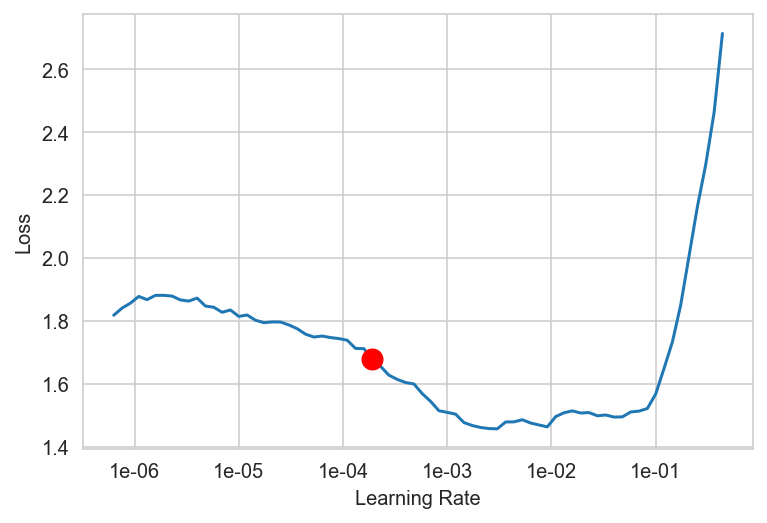

In [109]:
learn.lr_find()
learn.recorder.plot(suggestion=True)

In [110]:
min_grad_lr = learn.recorder.min_grad_lr
min_grad_lr

0.00019054607179632462

Looking at the plot, we can notice three main regions of interest:
* The leftmost region presents a relatively flat loss for smaller values of learning rate. Hence, this is not an optimal learning rate (LR) region
* The middle region presents a concave section where the loss features a decreasing pattern. This is an optimal LR region.
* The rightmost section presents an increasing trend in the loss. This LR ranges is suboptimal. 

----
**ONE CYCLE POLICY & DISCRIMINATIVE LEARNING**

The **<mark>fit_one_cycle()<mark/>** method, resulting from Leslie Smith's research on one cycle policy, is known to have better performance in speed and accuracy over the fit() method. According to this methodology, the learning rate is small at first and then progressively increases, to decrease again after a peak. Initial layers need less tuning, while later layers which need higher tuning especially fully connected ones. <br/>
As mentioned in the [fast.ai video](https://course.fast.ai/videos/?lesson=6), after having frozen the pre-trained model layers it's common to include a first ```slice(stop = lr_stop)``` in the ```fit_one_cycle()``` method. This way, the last parameter group will use a learning rate of ```lr_stop```, while the other groups will have ```lr_stop/10```. Now, you might wander - how do we determine the value of ```lr_stop```? A common method is to run the ```lr_find()``` method and to identify the point on the loss curve with the steepest gradient. Adding ```suggestion=True``` can help better identify the point in question.
    
Once the learner has been unfrozen, we need to reapply the ```fit_one_cycle()```, but this time we will mention both *start* and *stop* parameters in the slice for *max_lr*. So, we will end up with a syntax like ```max_lr = slice(start = lr_start, stop = lr_stop, step = None)```. This means that the first layer will be trained with ```lr_start``` learning rate, the last layer will be trained with ```lr_stop``` learning rate and the layers in between will be equally spaced. Now, to find ```lr_start``` and ```lr_stop``` we need to rerun the ```lr_find()``` and, looking at the curve, we should identify the point after which the loss starts increasing again and set this as the end point of a range of around one unit. It's important to note that this last method is fairly empirical and there is not much documentation yet on how to best set this slice parameter.     
    
----    

In [111]:
# train model with fastai's implementation of Leslie Smith's one cycle policy
learn.fit_one_cycle(8, max_lr=slice(min_grad_lr)) # 8 epochs and max_lr = slice(start = None, stop = 1.91e-04, step = None)

epoch,train_loss,valid_loss,error_rate,time
0,1.230419,0.214674,0.093333,15:16
1,0.943342,0.173604,0.071111,15:04
2,0.826577,0.140213,0.057778,14:26
3,0.789773,0.155409,0.048889,14:24
4,0.759485,0.141656,0.048889,14:29
5,0.720183,0.125670,0.040000,14:30
6,0.688408,0.135917,0.044444,14:25
7,0.685745,0.132086,0.035556,14:51


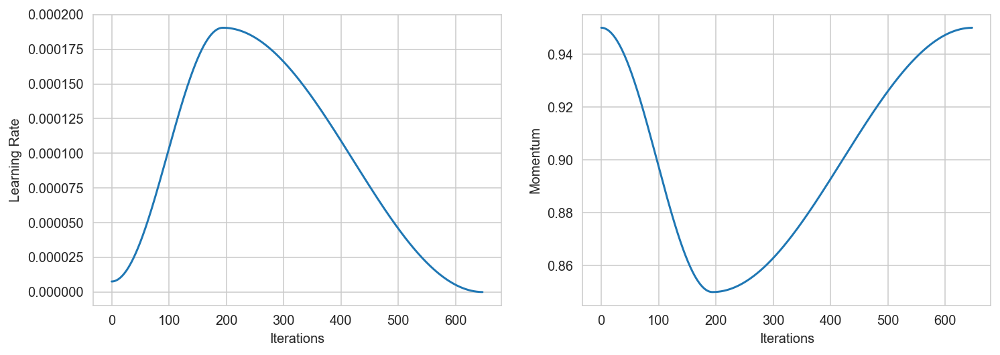

In [112]:
# show learning rate and momentum for different iterations
learn.recorder.plot_lr(show_moms=True)

In [113]:
# save model
learn.save('food_mix_1') 

### 2. Training Phase 2 | unfreeze ResNet50 layers and train the whole model

In [114]:
learn.unfreeze()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


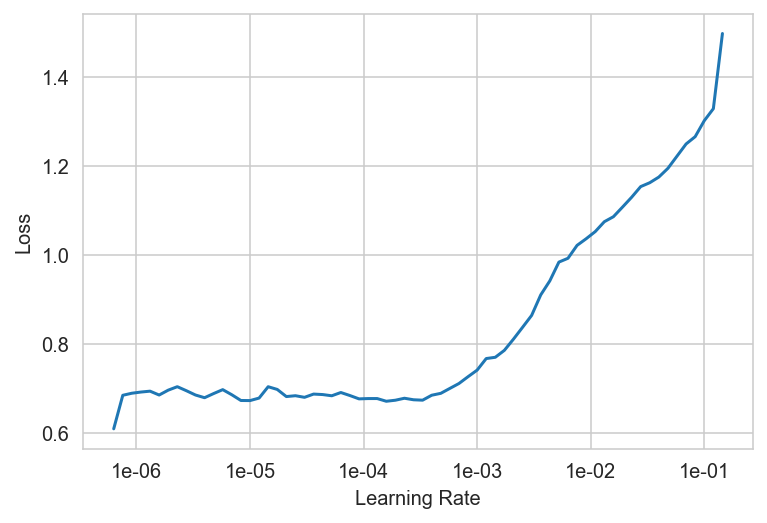

In [115]:
# rerun the method to find optimal lr
learn.lr_find()
learn.recorder.plot()

> As we note here, it is much harder to train a model that is already pretty good. Hence, we observer a very gentle gradient. As mentioned above, the point with the max gradient isn't what we are looking for here. On the contrary, the optimal end point of the slice range is **between 1e-4 and 1e-5**. We will compute it below.

In [124]:
# compute end of slice range (lr_stop)
a=1e-4
b=1e-3
midway_stop = exp((log(a)+log(b))/2)
midway_stop

0.0003162277660168384

In [126]:
# compute start of slice range (lr_start)
c=1e-5
d=1e-4
midway_start = exp((log(c)+log(d))/2)
midway_start

3.16227766016838e-05

In [128]:
# discriminative learning rates - small learning rate for earlier layers and large learning rate for later layers
learn.fit_one_cycle(12, max_lr=slice(midway_start,midway_stop)) # 12 epochs and max_lr = slice(start = 1e-5, stop = 1e-3, step = None)

epoch,train_loss,valid_loss,error_rate,time
0,0.669268,0.130634,0.040000,19:58
1,0.712963,0.168525,0.044444,19:33
2,0.699102,0.154000,0.048889,19:31
3,0.702307,0.135284,0.040000,21:01
4,0.620486,0.161892,0.057778,23:34
5,0.577660,0.139076,0.040000,20:46
6,0.564272,0.141600,0.035556,21:00
7,0.533285,0.108673,0.026667,20:49
8,0.501297,0.138557,0.035556,20:48
9,0.478072,0.120686,0.031111,20:57


> After epoch 10, the validation loss and error rate start increasing again. When we run our full scaled version of the model on Colab, we might consider rerunning this part of the model with **10 epochs instead of 12**. 

In [136]:
learn.save('food_mix_2')

In [137]:
learn.load('food_mix_2');

In [138]:
# interpret classification output
model_interp = ClassificationInterpretation.from_learner(learn)
losses,idxs = model_interp.top_losses()

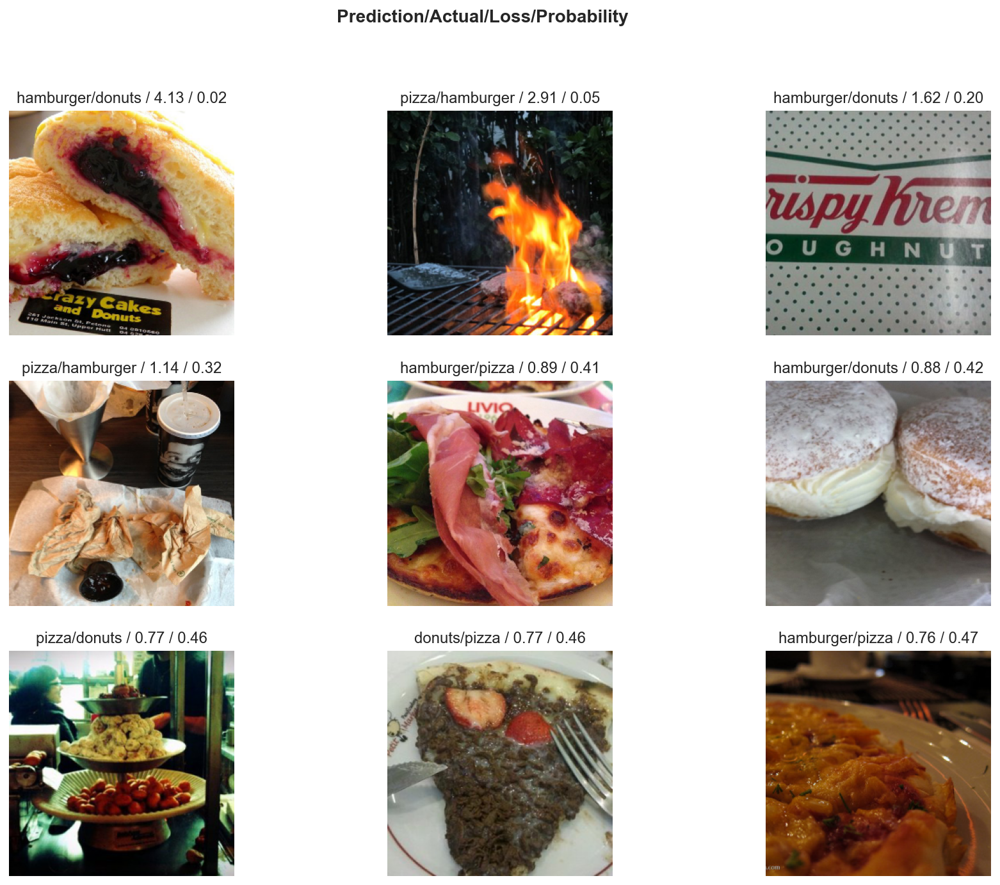

In [140]:
# identify most misclassified classes
model_interp.plot_top_losses(9, figsize=(15,11), heatmap=False)

----

This plot presents what are defined as **top losses** on the validation set. These are instances where the model is misclassifying an image and is highly confident in this misclassification. Every image presents a header showing the following information: ```predicted class / actual class / loss / probability of actual class```.

----

Starting from the top left of the plot and commenting in the format ```row | col```:
* Image 1|1: predicted as a hamburger but is actually a donut. This might be due to the fact that this donut has some sort of a *bun* shape.
* Image 1|2: predicted as pizza but it was a hamburger instead. I am not sure how this could be classified as a pizza. Let's remember that this dataset has been built with a certain degree of noise in the training set. Hence, we could have some **images that are misclassified in the metadata**.
* Image 1|3: donuts are mistaken for a hamburger. Interestingly, this picture shows no food, but just a box of krispy kreme. This might be the origin of the confusion.
* Image 2|1: hamburger mistaken for a pizza. Again, we see no food in the picture, which could be the cause of the misclassification.
* Image 2|2: pizza mistaken for a hamburger. Here, the pizza has a bit of a condensed (small) round shape and typical cheese like mozzarella is not visible.
* Image 2|3: classified as hamburger but is a donut instead. Here the food is pretty visible and identifiable as a donut. It might be the case that this image was misclassified in the metadata.
* Image 3|1: donut misclassified as pizza. Here, it's very difficult to identify donuts. These look more like pastries. 
* Image 3|2: pizza misclassified as donut. This looks like a *sweet pizza* with Nutella and strawberries. Maybe the model picked up the signal for those *sweet and creamy ingredients* and misclassified the image.
* Image 3|3: pizza misclassified as hamburger. Honestly, this food image does not look much like a pizza and is a pretty dark image. However, we can pick the edge of the crust and the tomato sauce. 

In [144]:
# identify most confused classes
model_interp.most_confused()

[('donuts', 'hamburger', 4),
 ('hamburger', 'pizza', 2),
 ('pizza', 'hamburger', 2),
 ('donuts', 'pizza', 1),
 ('pizza', 'donuts', 1)]

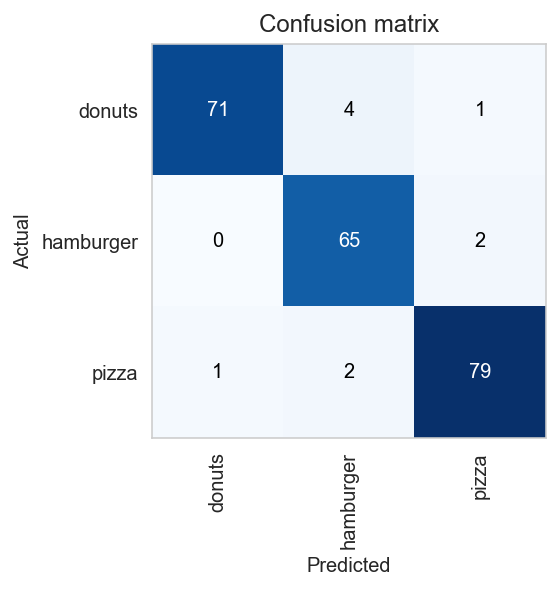

In [145]:
# plot confusion matrix
model_interp.plot_confusion_matrix()

As we can see by plotting the **most confused classes** as well as the **confusion matrix**, we notice that the sum of the off-diagonal elements in the confusion matrix matches with the sum of the misclassification instances in the *most_confused* plot. They both show a total of 10 misclassified instances on the validation set. <br/>

The most commonly misclassified instance is **donuts/hamburger**, where actual donuts images are predicted to be hamburger images instead.

### 3. Prediction on Test set

**Test Time Augmentation (TTA)** is an application of data augmentation to the test dataset. In particular, it involves randomly creating multiple augmented copies of each image in the test set, having the model make a prediction for each, then returning an ensemble of those predictions. <br/>
We will run two sets of predictions, one with and one without TTA.

### Predictions without TTA

In [155]:
# specify path
path_mini = '/Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini/'

In [158]:
# ignore warning
import warnings
warnings.filterwarnings('ignore')

In [159]:
# create dataloader from test data
data_test = (ImageList.from_folder(path_mini).split_by_folder(train='train_mini', valid='test_mini')
                                       .label_from_folder(classes=None)
                                       .transform(tfms=tfms, size=216)
                                       .databunch(bs=bs, num_workers=8))

In [160]:
learn.data = data_test

In [161]:
learn.data

ImageDataBunch;

Train: LabelList (2250 items)
x: ImageList
Image (3, 216, 216),Image (3, 216, 216),Image (3, 216, 216),Image (3, 216, 216),Image (3, 216, 216)
y: CategoryList
donuts,donuts,donuts,donuts,donuts
Path: /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini;

Valid: LabelList (750 items)
x: ImageList
Image (3, 216, 216),Image (3, 216, 216),Image (3, 216, 216),Image (3, 216, 216),Image (3, 216, 216)
y: CategoryList
donuts,donuts,donuts,donuts,donuts
Path: /Users/valentinarizzati/Desktop/GitStuff/Projects/DeepLearning-Instagram/data/food_101/food-101/food-101/images/mini;

Test: None

In [162]:
# compute predictions
preds, y = learn.get_preds()

In [163]:
# top-1 accuracy
accuracy(preds, y)

tensor(0.9800)

In [166]:
# compute the Top-k accuracy (target is in the top k predictions)
## top-2 accuracy
top_k_accuracy(preds, y, k=2)

tensor(0.9987)

----

Without applying TTA, our model has a **<mark>98.0% top-1 accuracy<mark/>** and **<mark>99.9% top-2 accuracy<mark/>**.

----

### Predictions with TTA

Conducting predictions with TTA will imply performing **9 predictions**. One set of predictions will be on the non-augmented test set. Then, the other 8 predictions will be on augmented versions of the test set images. The final prediction will be the linear interpolation between the non-augmented prediction and the average of the augmented predictions. In order to control the interpolation, the parameter ```beta``` will be used. For instance, ```beta = 0.4```, the model will take 40% of the unaugmented prediction and 60% of the average of the augmented predictions.

In [167]:
preds_tta, y_tta = learn.TTA(beta=0.4, scale=1.05) # scale parameter controls scale for zoom (not random)

In [168]:
# top-1 accuracy
accuracy(preds_tta, y_tta)

tensor(0.9853)

In [169]:
# top-2 accuracy
top_k_accuracy(preds_tta, y_tta, k=2)

tensor(0.9987)

----

Running the model with TTA increases our **<mark>top-1 accuracy from 98.0% to 98.5%<mark/>**, while it doesn't impact our top-2 accuracy. This is likely due to the fact that we are only running this prototype model on 3 classes; hence, the top-2 (k = 2 classes) accuracy will likely not be impacted by TTA.

----

## Interpreting predictions and model performance

Even if we are quite satisfied with our top-1 accuracy, we should go deeper and understand how the model is truly performing.

In [170]:
# rerun interpretations
interp = ClassificationInterpretation.from_learner(learn)
losses,idxs = interp.top_losses()

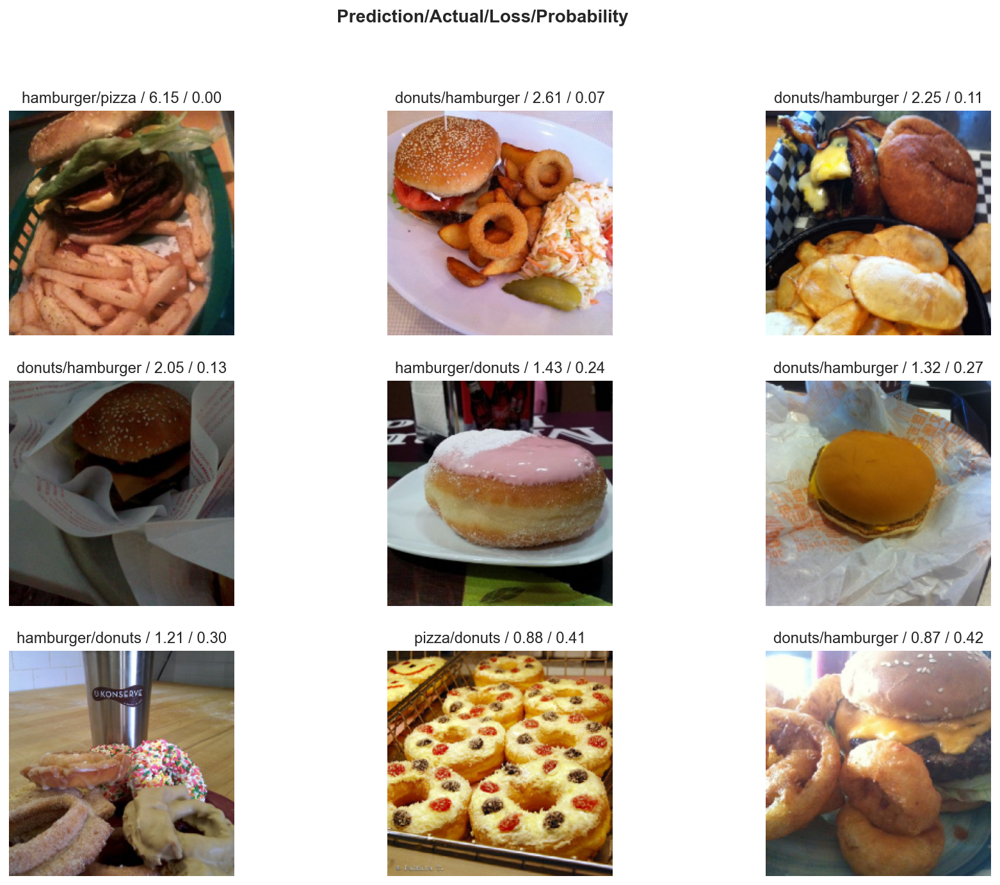

In [171]:
# plot images
interp.plot_top_losses(9, figsize=(15,11), heatmap=False)

In [172]:
# identify most confused classes
interp.most_confused()

[('hamburger', 'donuts', 10),
 ('donuts', 'hamburger', 3),
 ('donuts', 'pizza', 1),
 ('pizza', 'hamburger', 1)]

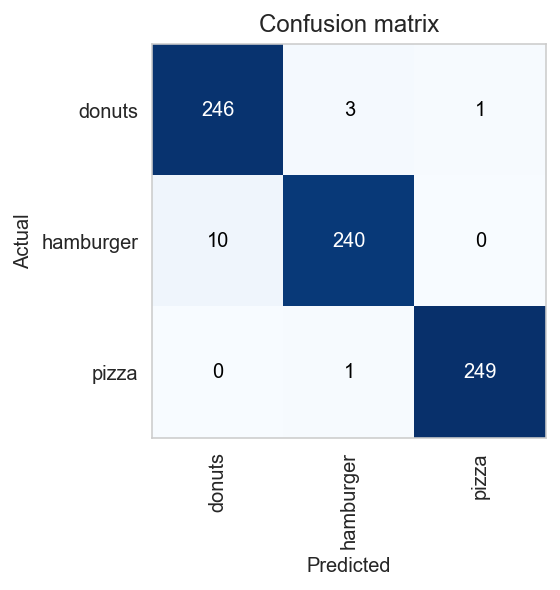

In [173]:
# plot confusion matrix
interp.plot_confusion_matrix()

----

Interestingly, while the most common misclassification on validation set was ```('donuts', 'hamburger')```(actual donuts mistaken for hamburgers), on the test set this is actually the second most common misclassification. The most common misclassification on the test set is ```('hamburger', 'donuts')```(actual hamburgers mistaken for donuts). Either way, **hamburgers are donuts are sometimes mistaken for each other**, probably because of their round shape and their similar color. 

----

## TSNE Visualizations

Let's now use TSNE to see how predictions cluster in space. We will run TSNE on the prediction vectors from the TTA prediction; hence, softmax will already be applied. Softmax transforms a vector's values into values between 0 and 1, so that they can be interpreted as probabilities. In our specific case, the imapct of softmax is to make predictions to have one value that is close to 1, which has a good effect on clustering of classes.  

In [174]:
# apply tsne to tta predictions
probs_trans = manifold.TSNE(n_components=2, perplexity=15).fit_transform(preds_tta)

In [175]:
# create df
prob_df = pd.DataFrame(np.concatenate((probs_trans, y[:,None]), axis=1), columns=['x','y','labels'])

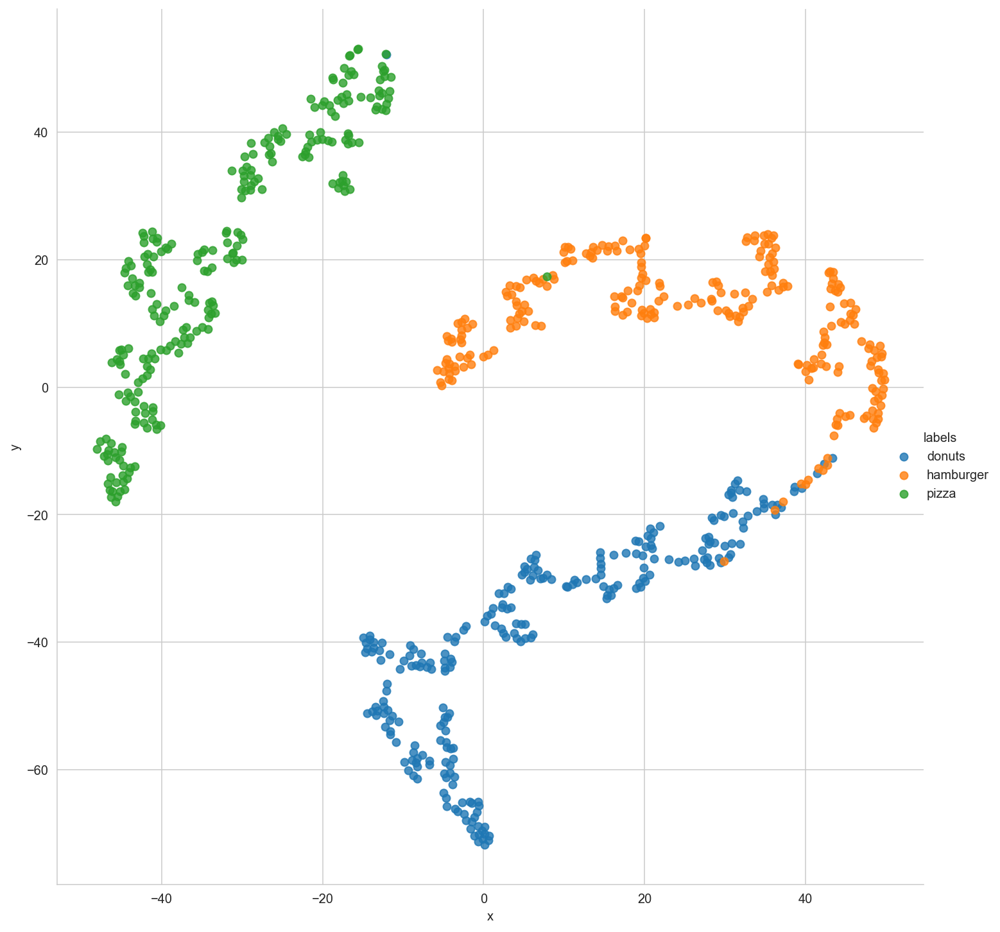

In [184]:
# plot tsne
food_classes = ['donuts', 'hamburger', 'pizza']
g = sns.lmplot('x', 'y', data=prob_df, hue='labels', fit_reg=False, legend=True, height=10, seed=42)

# rewrite legend
for t, l in zip(g._legend.texts, food_classes): 
    t.set_text(l)

As a reminder, TSNE is a technique for visualizing high-dimensional data in a low-dimensional space (2 dimendsions in this case). It attempts to preserve structure (distances) of points in the high-dimensional space in a low-dimensional space. <br/>

In our case, we see that the three **image classes are pretty well clustered**, aside from some misclassification occurring between the donuts and hamburger classes.<br/>

It's important to specify that The axes of a TSNE plot aren't easily interpretable in terms of the axes/units of the original, high-dimensional data. This is why TSNE plots are very useful to visualization purposes, but less interpretable from a purely quantitative perspective. 

## Conclusions & Next Steps

With a **top-1 accuracy of 98.5%** and **separable clusters of image classes** as confirmed by the TSNE plot, we are confortable with the performance of this current version of the model. Hence, we will now proceed with scaling this version of the model across all the 101 image classes on Google Colab.<br/>

A few model additions we might consider in Colab are:
* Train model on **512 x 512** resolution images, only if the model accuracy on 256 x 256 resolution images drops significantly once the model is extended to 101 image classes
* Train model in **fp16**. As specified in the [docs](https://docs.nvidia.com/deeplearning/performance/mixed-precision-training/index.html), "Half-precision floating point format (FP16) uses 16 bits, compared to 32 bits for single precision (FP32). Lowering the required memory enables training of larger models or training with larger mini-batches.".
* Train the model on **10 epochs** instead of 12 as, after epoch 10, the validation loss and error rate start increasing again